In [1]:
from PIL import Image
import matplotlib.pyplot as plt
import os
import numpy as np

In [2]:
def display_images_in_grid(images, titles='',N=2, M=2,display=False,gray=False):

    fig, axs = plt.subplots(N, M, figsize=(15, 15))  
    
    for i, ax in enumerate(axs.flat):  
        if i < len(images): 
            if gray == True :
                ax.imshow(images[i], cmap='gray') 
            else :
                ax.imshow(images[i]) 
            if display == True: 
                ax.set_title(titles[i])  
            ax.axis('off')  
        else:
            ax.axis('off')  

    plt.tight_layout()
    plt.show()

def display_histogram(images, titles='',N=2, M=2,display=False):
    fig, axs = plt.subplots(N, M, figsize=(15, 5)) 

    for i, ax in enumerate(axs.flat):  
        if i < len(images):  
    
            ax.hist(images[i].flatten(), bins=256)
            if display == True: 
                ax.set_title(titles[i])
            ax.axis('on') 
    plt.tight_layout()
    plt.show()           

In [3]:
def open_images(path):
    return Image.open(path)

<h1>Opération géométrique</h1>

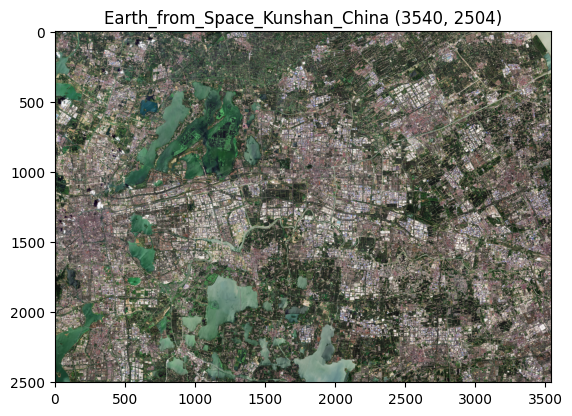

In [4]:
image = open_images('Earth_from_Space_Kunshan_China.jpg')
plt.imshow(image)
plt.title(f"Earth_from_Space_Kunshan_China {image.size}")
plt.axis('on')  
plt.show()

In [5]:

def display_pixel_positions(img,n):
    '''Display pixel'''
    #width, height = img.size
    for x in range(n):
        for y in range(n):
            print(f"Pixel at ({x}, {y}) has value {img.getpixel((x, y))}")


def crop_image(img, x, y, t1, t2):
    '''crop image'''
    cropped_img = img[x:t1, y:t2]
    cropped_img = Image.fromarray(cropped_img)
    cropped_img.save('cropped_image.jpg')
    return cropped_img


In [6]:
display_pixel_positions(image,200)

Pixel at (0, 0) has value (116, 103, 86)
Pixel at (0, 1) has value (100, 94, 70)
Pixel at (0, 2) has value (58, 71, 53)
Pixel at (0, 3) has value (127, 120, 104)
Pixel at (0, 4) has value (108, 93, 90)
Pixel at (0, 5) has value (116, 111, 108)
Pixel at (0, 6) has value (50, 63, 46)
Pixel at (0, 7) has value (90, 99, 72)
Pixel at (0, 8) has value (110, 117, 86)
Pixel at (0, 9) has value (84, 86, 64)
Pixel at (0, 10) has value (105, 99, 75)
Pixel at (0, 11) has value (78, 85, 69)
Pixel at (0, 12) has value (110, 111, 80)
Pixel at (0, 13) has value (92, 97, 75)
Pixel at (0, 14) has value (56, 68, 58)
Pixel at (0, 15) has value (100, 107, 74)
Pixel at (0, 16) has value (74, 90, 64)
Pixel at (0, 17) has value (80, 104, 70)
Pixel at (0, 18) has value (134, 140, 102)
Pixel at (0, 19) has value (172, 162, 126)
Pixel at (0, 20) has value (154, 161, 127)
Pixel at (0, 21) has value (219, 211, 200)
Pixel at (0, 22) has value (226, 213, 205)
Pixel at (0, 23) has value (231, 221, 209)
Pixel at (0, 2

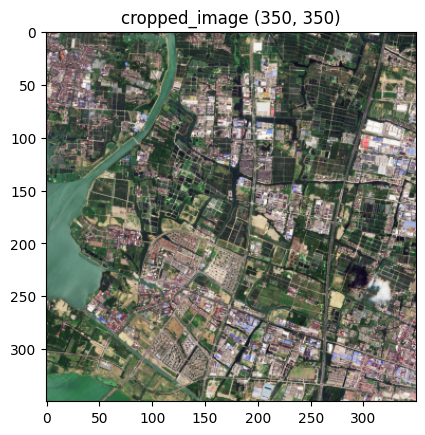

In [7]:
#exemple d'utilisation

image_array_1 = np.array(image)
cropped_image = crop_image(image_array_1, 50, 50, 400, 400)

plt.imshow(cropped_image)
plt.title(f"cropped_image {cropped_image.size}")
plt.axis('on')  
plt.show()

<h1>Compression</h1>

In [8]:
#sauvegarder en formats

def save_in_formats(img, folder_path='saved_images'):
    filename='cropped_image'
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
    
    formats = ['bmp', 'png', 'gif', 'tiff']
    
    for fmt in formats:
        file_path = os.path.join(folder_path, f'{filename}.{fmt}')
        img.save(file_path)
        print(f'Saved in {fmt}')

save_in_formats(cropped_image)

Saved in bmp
Saved in png
Saved in gif
Saved in tiff


In [9]:
#pour l'affichage
dossier_images = 'saved_images'
formats_autorises = ['bmp','jpg', 'gif', 'tiff', 'png']
images_fichiers = [f for f in os.listdir(dossier_images) if f.split('.')[-1].lower() in formats_autorises]
images_array = []

for fichier_image in images_fichiers:
    image_path = os.path.join(dossier_images, fichier_image)  
    image_open = open_images(image_path)  
    images_array.append(image_open) 

for i, img in enumerate(images_fichiers):
    print(f'{img}')
print(images_array)    

cropped_image.bmp
cropped_image.gif
cropped_image.png
cropped_image.tiff
[<PIL.BmpImagePlugin.BmpImageFile image mode=RGB size=350x350 at 0x263A8647290>, <PIL.GifImagePlugin.GifImageFile image mode=P size=350x350 at 0x263A8645340>, <PIL.PngImagePlugin.PngImageFile image mode=RGB size=350x350 at 0x263A86471A0>, <PIL.TiffImagePlugin.TiffImageFile image mode=RGB size=350x350 at 0x263A8645FD0>]


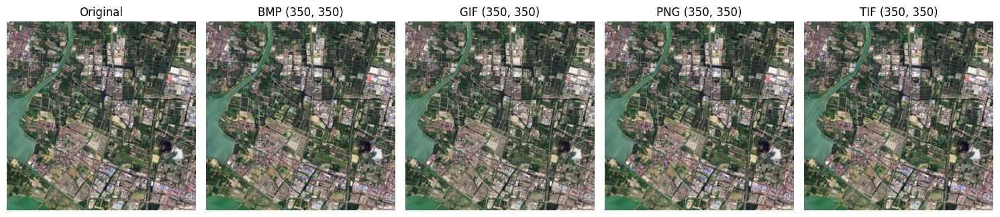

In [10]:
display_images_in_grid([cropped_image,images_array[0], images_array[1], images_array[2], images_array[3]], [f'Original',f'BMP {images_array[0].size}', f'GIF {images_array[1].size}', f'PNG {images_array[2].size}', f'TIF {images_array[3].size}'],1,5,True)

Note : Le mode P utilise une palette de couleurs, ce qui signifie qu'au lieu de stocker les valeurs RGB pour chaque pixel, l'image stocke des indices qui pointent vers une table de couleurs. Chaque indice représente une couleur spécifique dans la palette.

In [11]:
for i, img in enumerate(images_array):
    largeur, hauteur = img.size
    mode = img.mode
    print(f'Image {images_fichiers[i]} , dimension : {mode}')

Image cropped_image.bmp , dimension : RGB
Image cropped_image.gif , dimension : P
Image cropped_image.png , dimension : RGB
Image cropped_image.tiff , dimension : RGB


In [12]:
def calculate_eqm(original_img, processed_img):

    original = np.array(original_img)
    processed = np.array(processed_img)
    if original.shape != processed.shape:
        return ValueError("Images must have the same dimensions")

    M, N, C = original.shape 
    eqm_value = (1 / (M * N * C)) * np.sum((original - processed) ** 2)
 
    return eqm_value


In [13]:
for i in images_array:
    eqm_result = calculate_eqm(cropped_image, i)
    print(f"Erreur Quadratique Moyenne {i.format} : {eqm_result}")

Erreur Quadratique Moyenne BMP : 0.0
Erreur Quadratique Moyenne GIF : Images must have the same dimensions
Erreur Quadratique Moyenne PNG : 0.0
Erreur Quadratique Moyenne TIFF : 0.0


In [14]:
gif_image_format  = images_array[1].convert('RGB')
print(f"Erreur Quadratique Moyenne GIF : {calculate_eqm(cropped_image, gif_image_format)}")

Erreur Quadratique Moyenne GIF : 15.03810068027211


Donc lors de la compression la taille de l'image a changer :

image original cropped : 41 ko
image bmp cropped : 360 ko
image gif cropped : 143 ko
image png cropped : 283 ko
image tiff cropped : 360 ko

Les fichiers BMP et TIFF, bien que volumineux, préservent tous les détails de l'image



Donc, pour le format GIF, on observe une grande différence par rapport à l'image originale. La perte de couleurs dans ce format affecte nettement la qualité, ce qui entraîne une diminution des détails et une apparence moins réaliste. De plus, la compression GIF limite la palette de couleurs, ce qui impacte la fidélité visuelle de l'image par rapport aux autres formats. 

<h1>Rehaussement de contraste</h1>

In [15]:
#- Création d’une fonction qui effectuer une égalisation d’histogramme sur les images aux niveaux de gris (les 3 niveaux de gris de l’mage RGB découper) et observer le résultat obtenu (comparer avec les images originales).

def Split_RGB(img):

    img = np.array(img)
    R = img[:, :, 0]  
    G = img[:, :, 1]  
    B = img[:, :, 2]  

    return R, G, B

In [16]:
def Split_RGB_precessing(img):
    RGB_split_images = Split_RGB(img)
    display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
    return RGB_split_images 

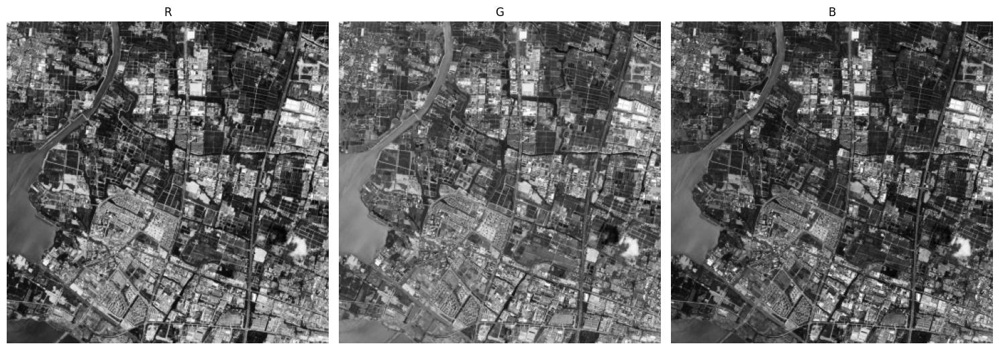

In [17]:
RGB_split_images = Split_RGB_precessing(cropped_image)

In [18]:
#représente la fréquence de chaque niveau de gris
def calculate_histogram(image):
    pixels = np.array(image)
    histogramme = [0] * 256

    for y in range(hauteur):
        for x in range(largeur):
            r = pixels[x, y]

            histogramme[r] += 1
 
    return  histogramme         

In [19]:
res = calculate_histogram(RGB_split_images[0])
print(res[15:30])

[9, 13, 23, 19, 43, 49, 74, 99, 132, 164, 270, 332, 418, 485, 533]


In [20]:
def histogram_equalization(image):
    hauteur, largeur = image.shape
    n = hauteur * largeur  
    
    histogramme = calculate_histogram(image)

    px = [h / n for h in histogramme] 

    hist_cumule = np.cumsum(px)
    
    L = 255  
    T = np.zeros(256)  

    for k in range(L):
        T[k] = L * hist_cumule[k]  

    img_equalisee = np.zeros_like(image)

    for y in range(hauteur):
        for x in range(largeur):
            img_equalisee[y, x] = T[image[y, x]]
    
    return img_equalisee

In [21]:
def equalized_images_processing(img):
    equalized_original_images = []
    for i in img:
        equalized_original_images.append(histogram_equalization((i)))

    print('original')    
    display_images_in_grid(img,['R','G','B'],1,3,True,True)
    display_histogram(img,'',1,3,False) 
    print('equalization') 
    display_images_in_grid(equalized_original_images,['R','G','B'],1,3,True,True) 
    display_histogram(equalized_original_images,'',1,3,False) 
    return equalized_original_images

original


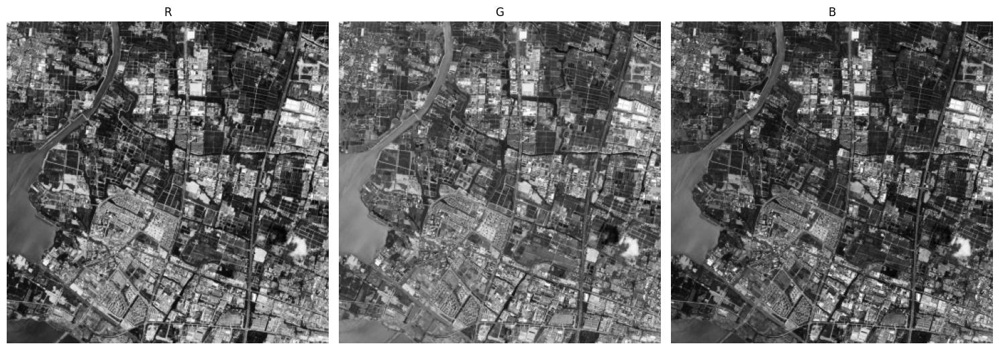

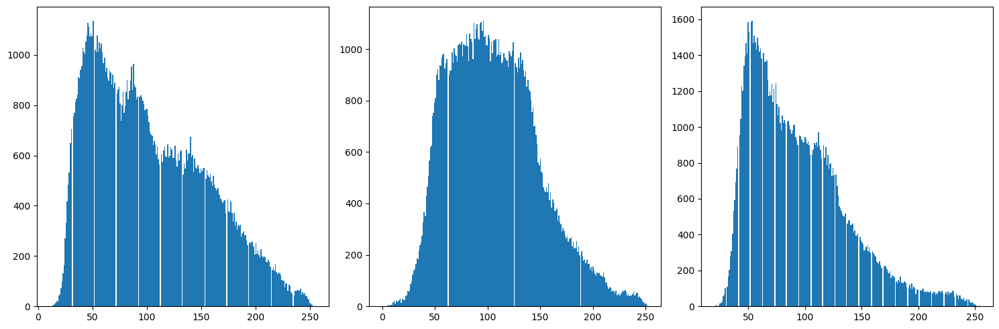

equalization


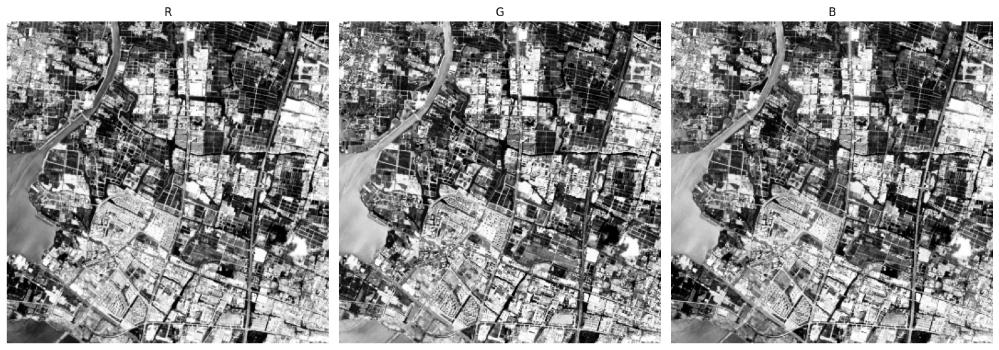

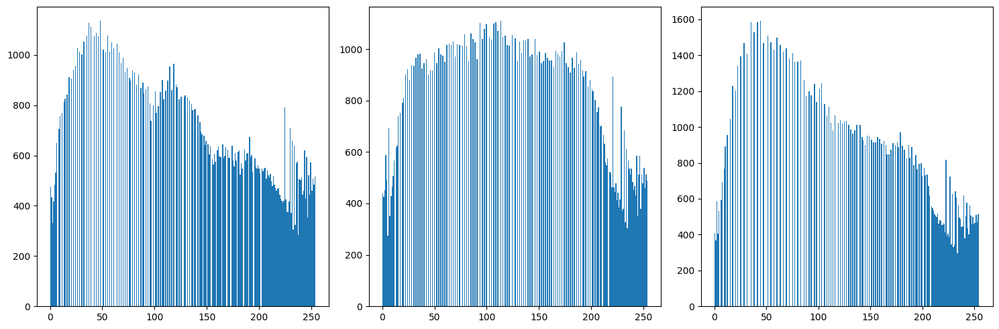

In [22]:
equalized_original_images = equalized_images_processing(RGB_split_images)

La différence principale entre les deux rangées d'images est le contraste, plus de détails dans les zones sombres ou claires de l'image.

In [23]:
def compo_images(r, g, b):

    image_composite = np.zeros((r.shape[0], r.shape[1], 3), dtype=r.dtype)

    image_composite[:, :, 0] = r  # Rouge
    image_composite[:, :, 1] = g  # Vert
    image_composite[:, :, 2] = b  # Bleu

    return image_composite

In [24]:
equalized_images_to_RGB = (compo_images(equalized_original_images[0], equalized_original_images[1], equalized_original_images[2]))


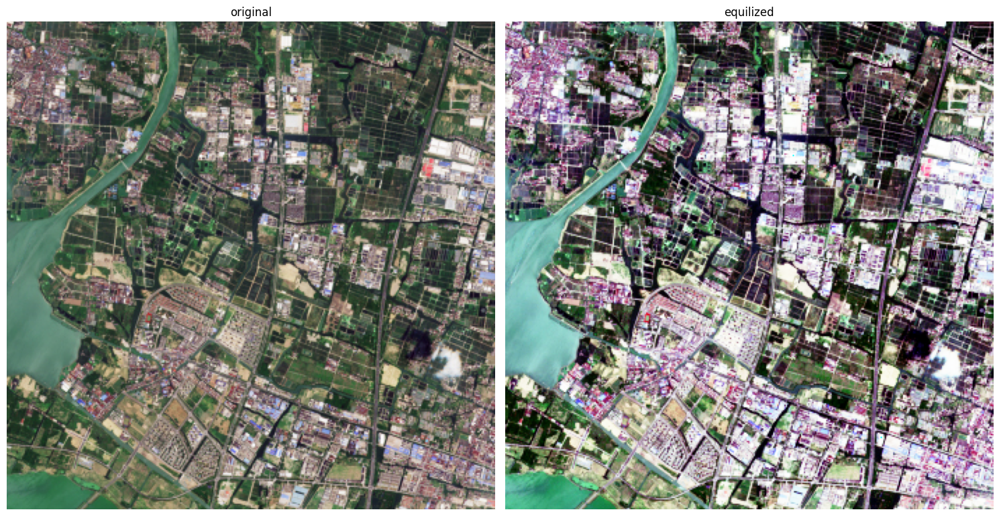

In [25]:
display_images_in_grid([cropped_image,equalized_images_to_RGB],['original','equilized'],1,2,True)

Après la composition des canaux, la différence principale entre l'image originale (à gauche) et l'image égalisée (à droite) est visible dans le contraste et la saturation des couleurs.Les zones urbaines et les surfaces d'eau sont plus nettes, et la diversité des tons verts et rouges dans la végétation et les infrastructures est accentuée.

In [28]:
#ne plus grande divergence entre les deux images en termes de valeurs de pixels


mse_value = calculate_eqm(cropped_image, equalized_images_to_RGB)
print(f'Erreur Quadratique Moyenne pour image original: {mse_value}')

Erreur Quadratique Moyenne pour image original: 109.54157006802721


OUI, en utilisant l’égalisation d’histogramme sur les 3 matrices des niveaux R, V et B individuellement, comme je viens de faire mais cela modifie les valeurs des canaux Rouge, Vert et Bleu indépendamment, ce qui peut perturber l’équilibre entre eux, menant à des couleurs non naturelles. Donc, l'utilisation de l’espace HSV ou YUV (comme proposé), pour ne pas perturber les teintes.
Appliquer l'égalisation seulement sur le canal de luminosité (comme dans l'espace HSV ou YUV) pour préserver la structure des couleurs.


In [124]:
pip install opencv-python


Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


(Hue, Saturation, Value) / White	#FFFFFF	(255,255,255)	(0°,0%,100%)
https://stackoverflow.com/questions/31998428/opencv-python-equalizehist-colored-image

In [30]:

import cv2

# imread needs 2 parameters. path and the flag
img = cv2.imread("cropped_image.jpg", 1)

# convert image from BGR to HSV
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

h, s, v_eq = cv2.split(img_hsv)
# Histogram equalisation on the V-channel
img_hsv[:, :, 2] = cv2.equalizeHist(img_hsv[:, :, 2])

image_hsv_eq = cv2.merge([h, s, v_eq])

# now the img_hsv has equalized
# now convert hsv image back from HSV to RGB
image_rgb_eq = cv2.cvtColor(img_hsv, cv2.COLOR_HSV2RGB)

-----------------RGB-----------------------


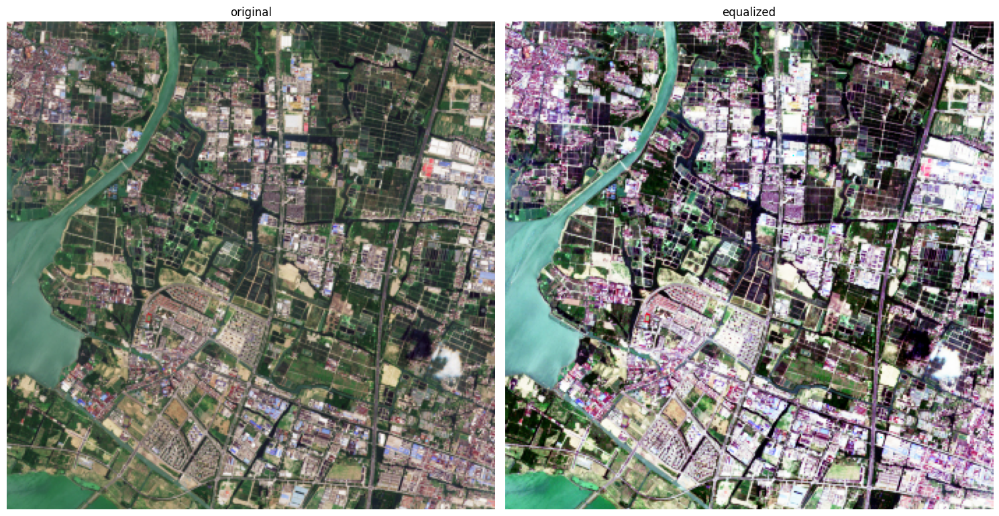

-------------------HSV----------------------


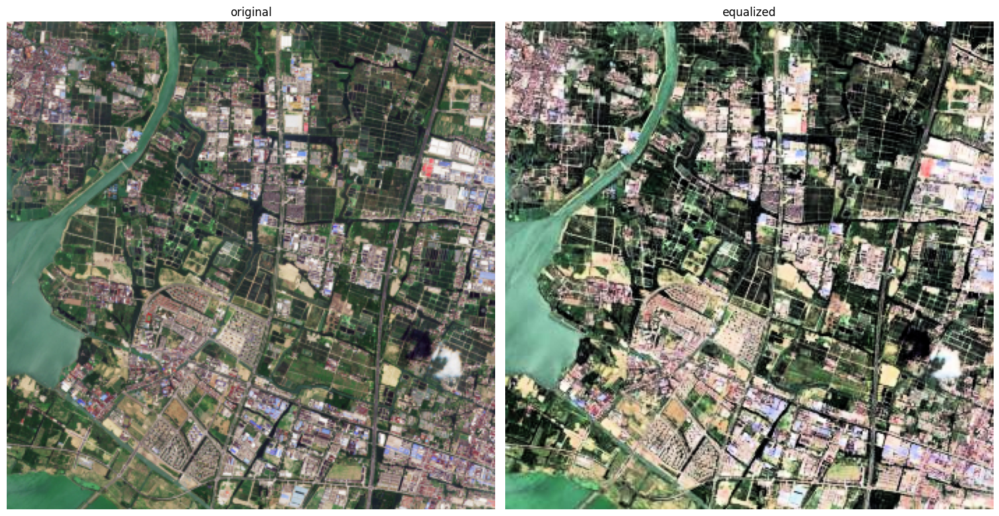

In [31]:
print('-----------------RGB-----------------------')
display_images_in_grid([cropped_image, equalized_images_to_RGB],['original','equalized'],1,2,True)
print('-------------------HSV----------------------')
display_images_in_grid([cropped_image, image_rgb_eq],['original','equalized'],1,2,True)

<h1>Reduction du bruit</h1>

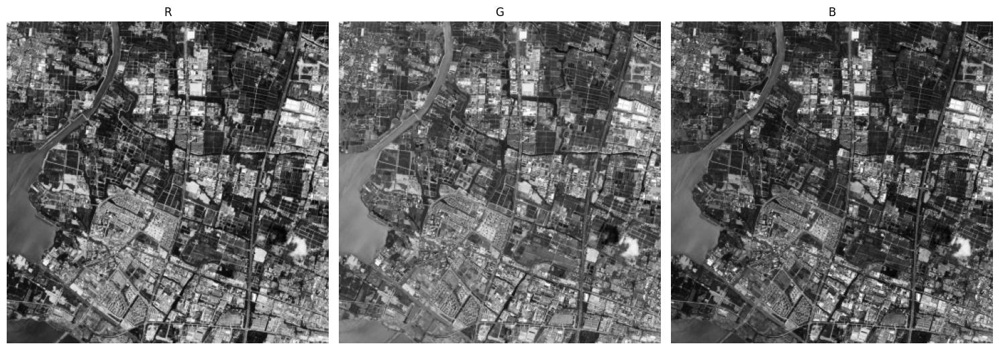

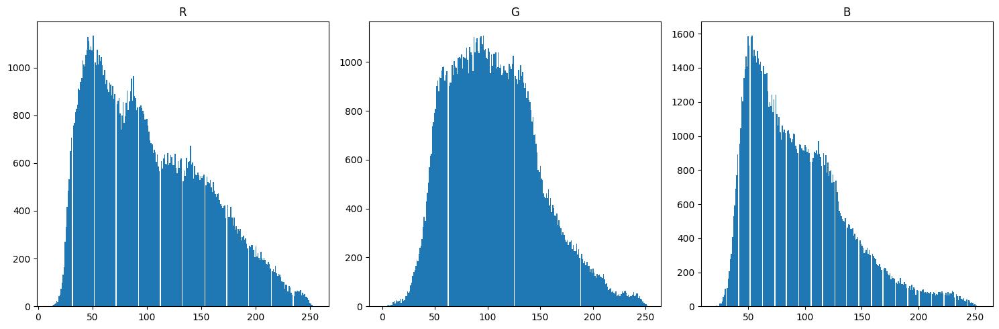

In [127]:
display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
display_histogram(RGB_split_images,['R','G','B'],1,3,True)

<h2>Filtre linéaire
</h2>

In [128]:
def convolve(image, kernel, gauss=False):

    fh, fw = kernel.shape
    ih, iw = image.shape
    filtered_image = np.zeros_like(image)
    padded_image = np.pad(image, ((fh // 2, fh // 2), (fw // 2, fw // 2)), mode='reflect')

    for y in range(ih):
        for x in range(iw):

            window = padded_image[y:y + fh, x:x + fw]
            result = np.sum(window * kernel)
            filtered_image[y, x] = result if gauss else result / np.sum(kernel)

    return filtered_image

In [129]:
def gaussian_filter(N, M, sigma):

    kernel = np.zeros((N, M))
    m = N // 2  
    n = M // 2  

    for i in range(N):
        for j in range(M):
            kernel[i, j] = (1 / (2 * np.pi * sigma**2)) * np.exp(-((i-m)**2 + (j-n)**2) / (2 * sigma**2))

    return kernel


In [130]:
def filtre_moy(kernel_size=3):
    kernel = np.ones((kernel_size, kernel_size), dtype=float)
    return kernel

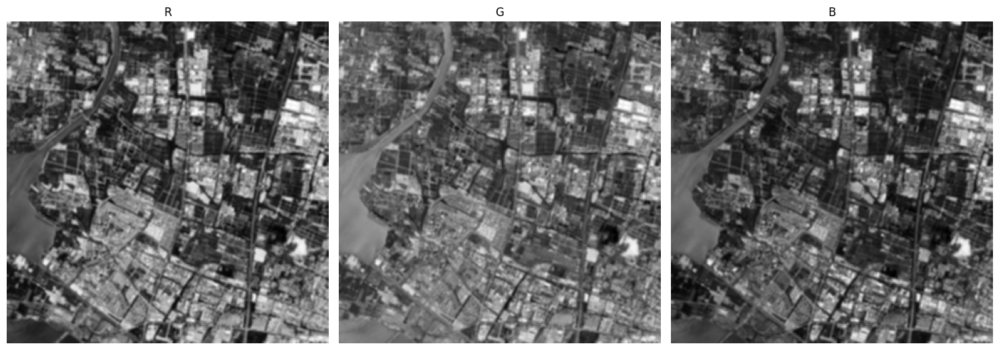

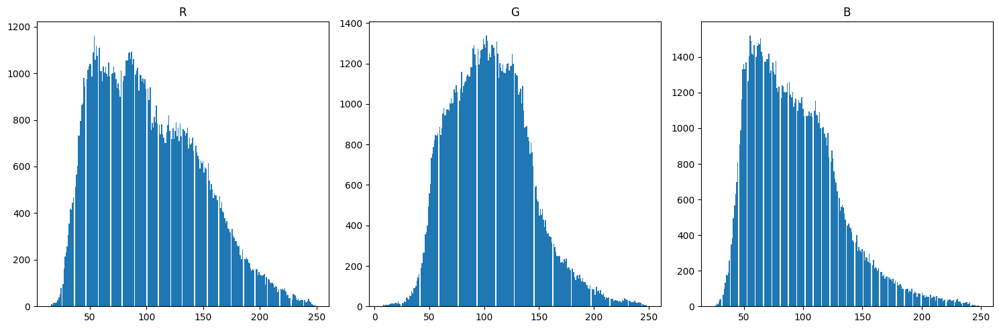

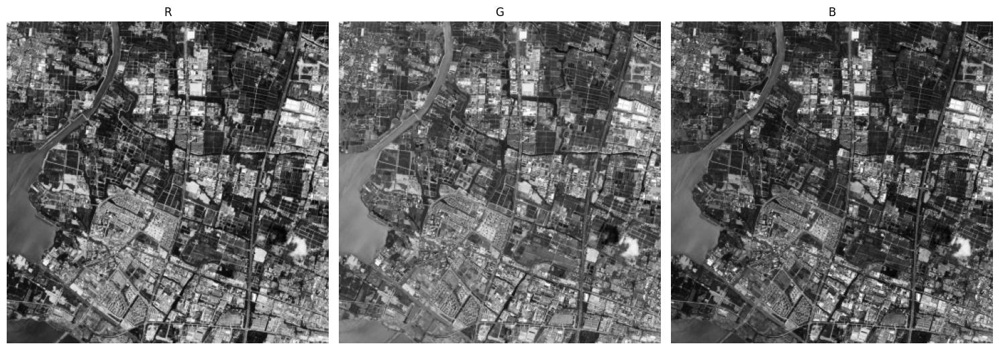

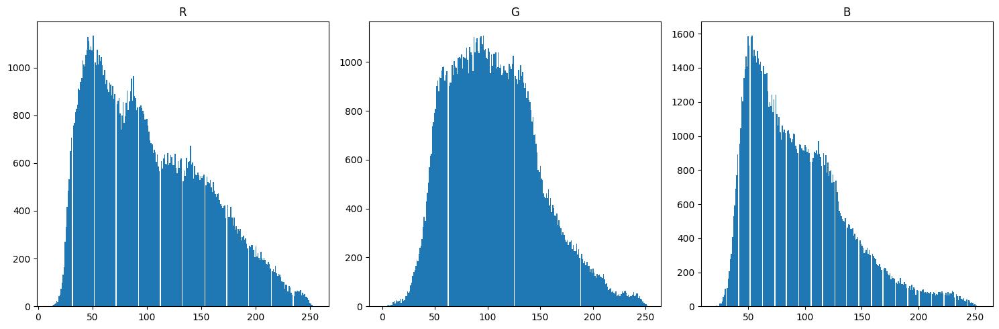

In [131]:
kernel = filtre_moy(3)
moyenneur_images = []

for i in RGB_split_images : 
    image = convolve(i,kernel)
    moyenneur_images.append(image)

display_images_in_grid(moyenneur_images,['R','G','B'],1,3,True,True)
display_histogram(moyenneur_images,['R','G','B'],1,3,True)

display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
display_histogram(RGB_split_images,['R','G','B'],1,3,True)


[[0.04219964 0.11707561 0.04219964]
 [0.11707561 0.32480601 0.11707561]
 [0.04219964 0.11707561 0.04219964]]


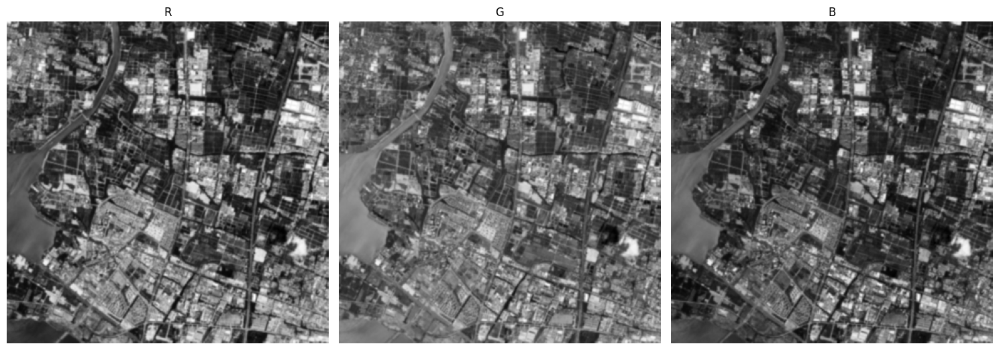

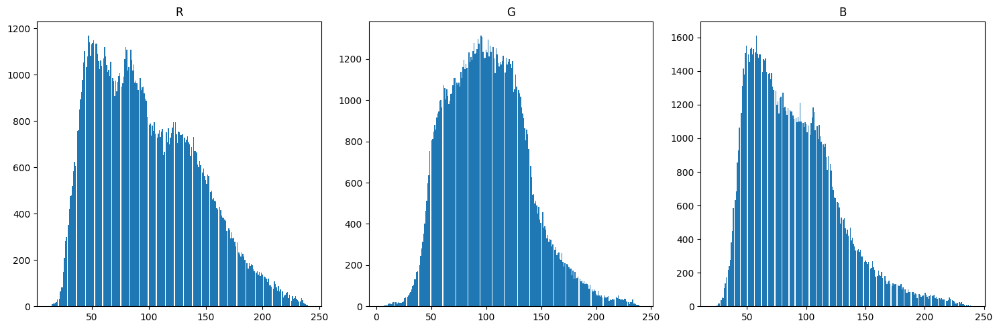

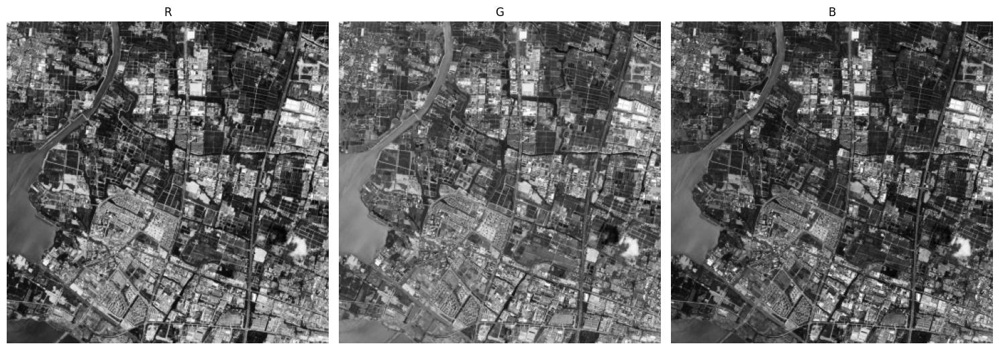

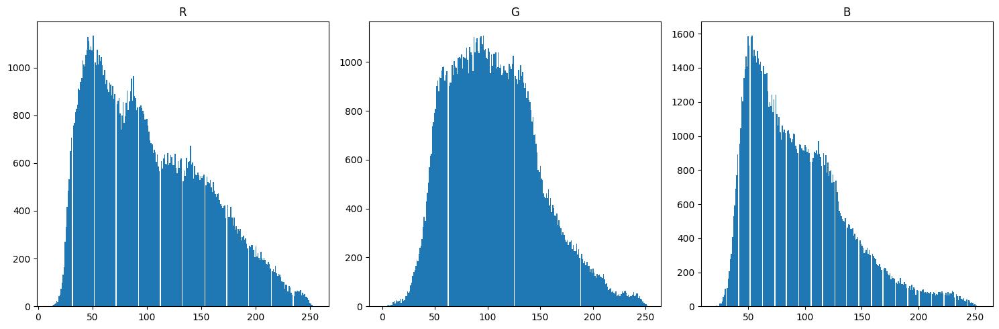

In [132]:
kernel = gaussian_filter(3,3,0.7)
print(kernel)
gaussian_images = []

for i in RGB_split_images : 
    image = convolve(i,kernel,True)
    gaussian_images.append(image)

display_images_in_grid(gaussian_images,['R','G','B'],1,3,True,True)
display_histogram(gaussian_images,['R','G','B'],1,3,True)  

display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
display_histogram(RGB_split_images,['R','G','B'],1,3,True)



<h2>Filtre non linéaire
</h2>

In [133]:
def median_filter(image):

    filtered_image = np.zeros_like(image)
    for y in range(1, image.shape[0] - 1): 
        for x in range(1, image.shape[1] - 1):
            window = image[y - 1:y + 2, x - 1:x + 2] 
            sort = np.sort(window)
            median = np.median(sort)
            filtered_image[y, x] = median

    filtered_image[:1, :] = image[:1, :]
    filtered_image[-1:, :] = image[-1:, :]
    filtered_image[:, :1] = image[:, :1]
    filtered_image[:, -1:] = image[:, -1:]        

    return filtered_image

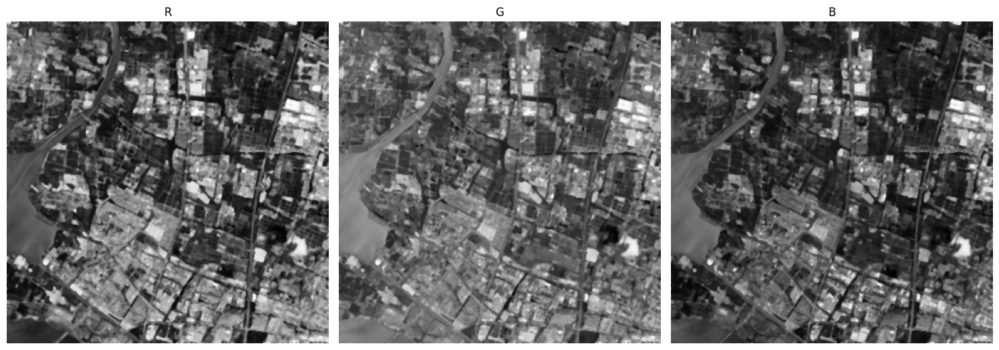

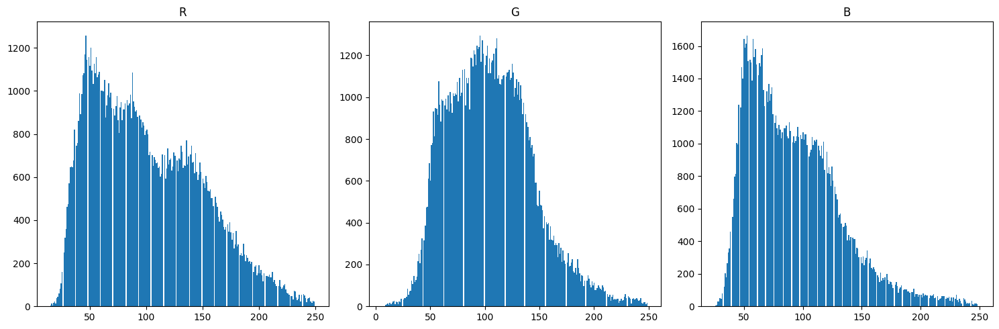

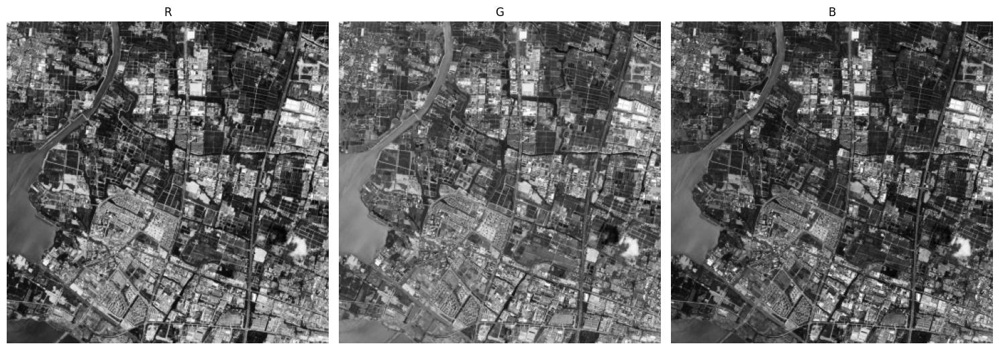

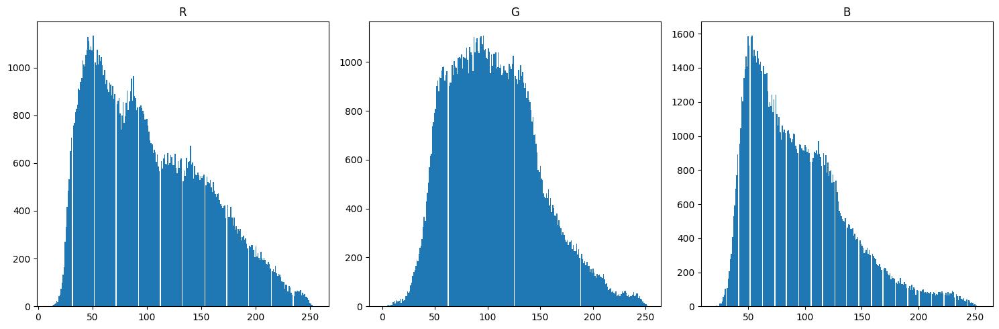

In [134]:
median_images = []

for i in RGB_split_images : 
    image = median_filter(i)
    median_images.append(image)

display_images_in_grid(median_images,['R','G','B'],1,3,True,True)
display_histogram(median_images,['R','G','B'],1,3,True)  

display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
display_histogram(RGB_split_images,['R','G','B'],1,3,True)


In [135]:
def max_filter(image):

    filtered_image = np.zeros_like(image)
    for y in range(1, image.shape[0] - 1): 
        for x in range(1, image.shape[1] - 1):
            window = image[y - 1:y + 2, x - 1:x + 2] 
            max_value = np.max(window)
            filtered_image[y, x] = max_value

    filtered_image[:1, :] = image[:1, :]
    filtered_image[-1:, :] = image[-1:, :]
    filtered_image[:, :1] = image[:, :1]
    filtered_image[:, -1:] = image[:, -1:]         

    return filtered_image



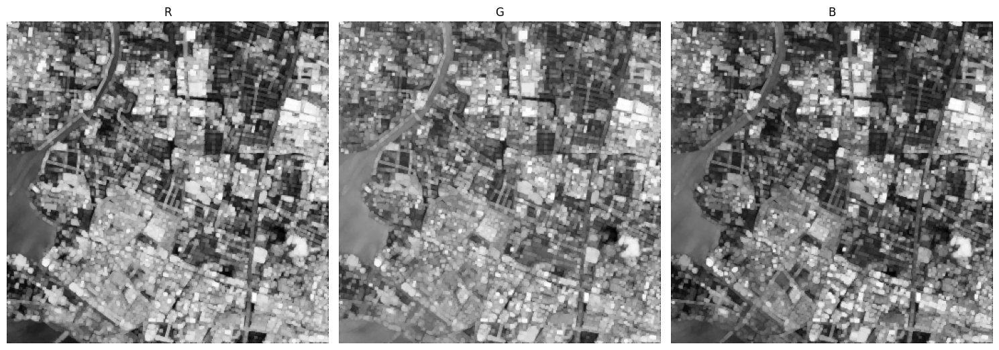

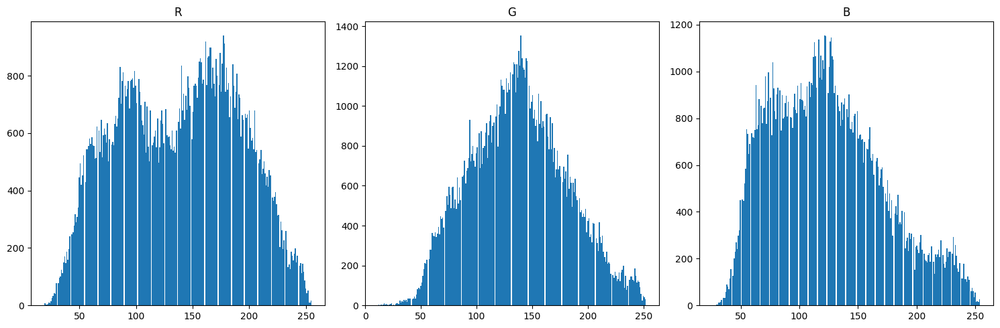

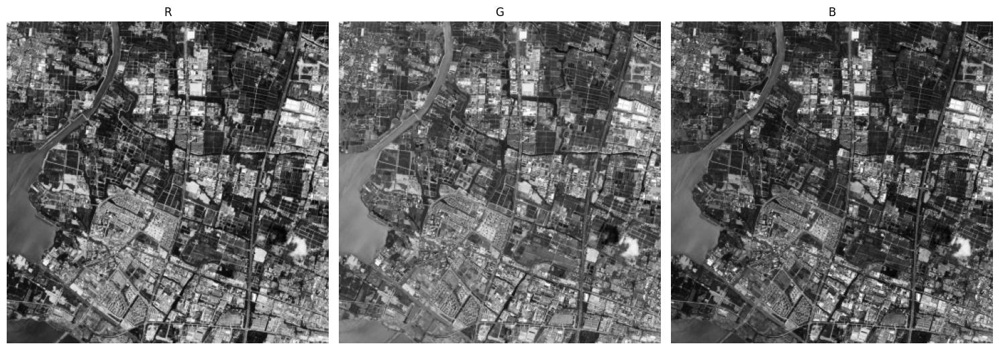

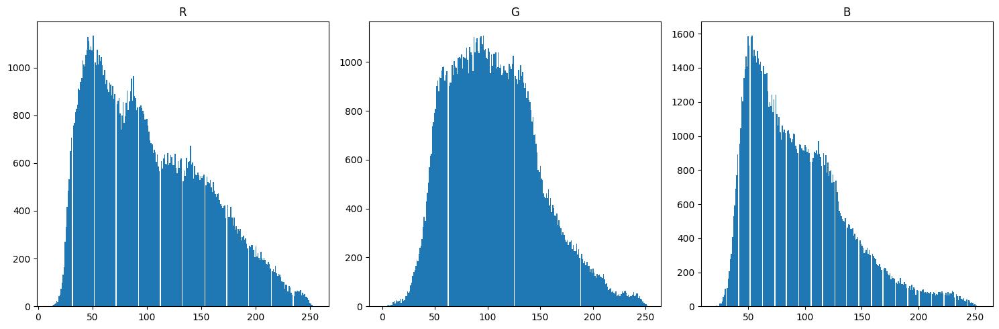

In [136]:
max_images = []

for i in RGB_split_images : 
    image = max_filter(i)
    max_images.append(image)

display_images_in_grid(max_images,['R','G','B'],1,3,True,True) 
display_histogram(max_images,['R','G','B'],1,3,True)  


display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
display_histogram(RGB_split_images,['R','G','B'],1,3,True)


In [137]:
def min_filter(image):

    filtered_image = np.zeros_like(image)
    
    for y in range(1, image.shape[0] - 1): 
        for x in range(1, image.shape[1] - 1):
            window = image[y - 1:y + 2, x - 1:x + 2] 
            min_value = np.min(window)
            filtered_image[y, x] = min_value

    filtered_image[:1, :] = image[:1, :]
    filtered_image[-1:, :] = image[-1:, :]
    filtered_image[:, :1] = image[:, :1]
    filtered_image[:, -1:] = image[:, -1:]         

    return filtered_image

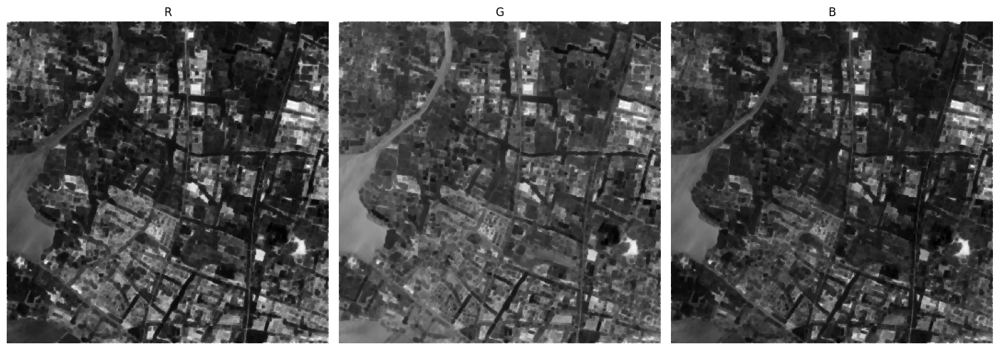

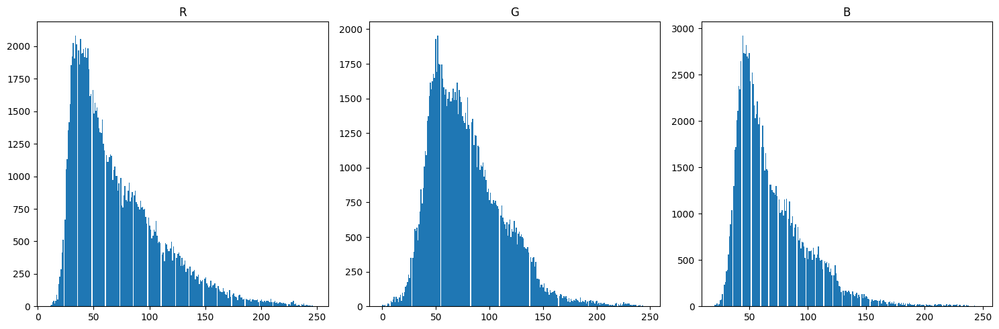

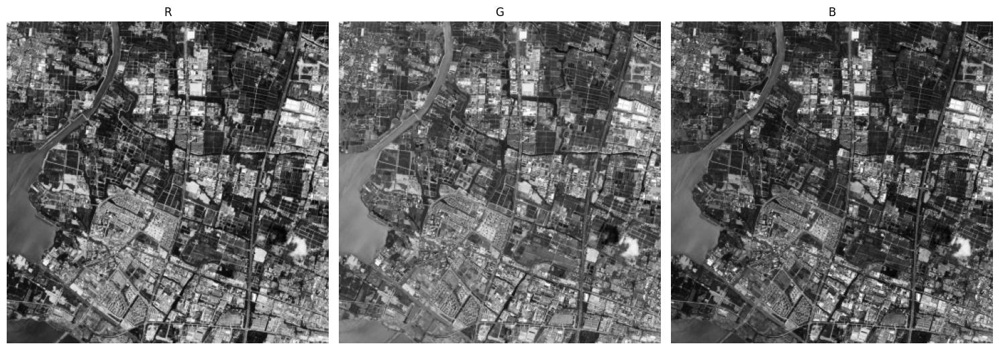

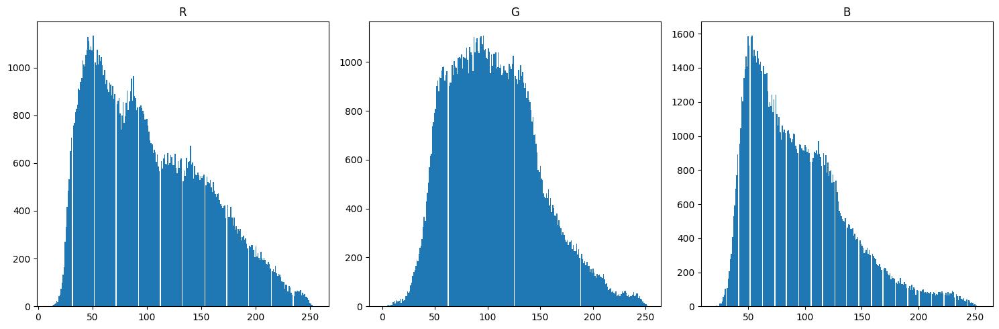

In [138]:
min_images = []

for i in RGB_split_images : 
    image = min_filter(i)
    min_images.append(image)

display_images_in_grid(min_images,['R','G','B'],1,3,True,True) 
display_histogram(min_images,['R','G','B'],1,3,True)  

display_images_in_grid(RGB_split_images,['R','G','B'],1,3,True,True)
display_histogram(RGB_split_images,['R','G','B'],1,3,True)


In [139]:
compo_gaussian_images = compo_images(gaussian_images[0], gaussian_images[1], gaussian_images[2])
compo_moyenneur_images = compo_images(moyenneur_images[0], moyenneur_images[1], moyenneur_images[2])
compo_median_images = compo_images(median_images[0], median_images[1], median_images[2])
compo_max_images = compo_images(max_images[0], max_images[1], max_images[2])
compo_min_images = compo_images(min_images[0], min_images[1], min_images[2])

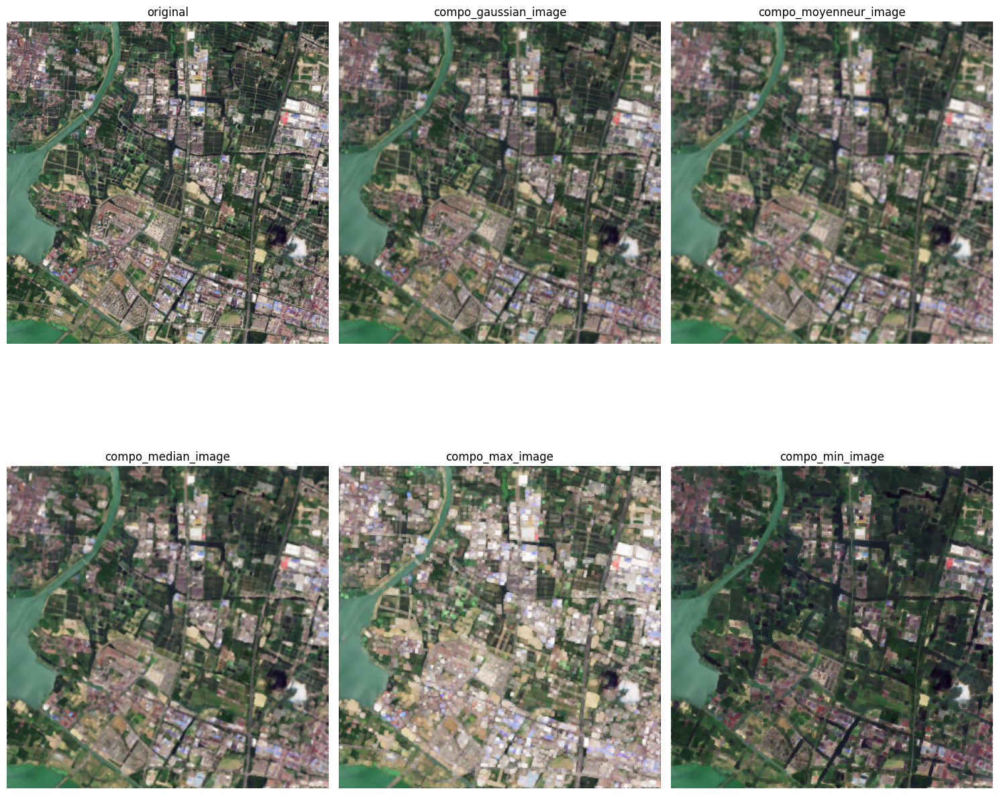

In [140]:
display_images_in_grid([cropped_image,compo_gaussian_images,compo_moyenneur_images,
compo_median_images,
compo_max_images,
compo_min_images],['original','compo_gaussian_image','compo_moyenneur_image',
'compo_median_image',
'compo_max_image',
'compo_min_image'],2,3,True)

In [141]:
images_dict = {
    "Gaussian Image": compo_gaussian_images,
    "Moyenneur Image": compo_moyenneur_images,
    "Median Image": compo_median_images,
    "Max Image": compo_max_images,
    "Min Image": compo_min_images,
}

for name, image_list in images_dict.items():
    mse_value = calculate_eqm(cropped_image, image_list) 
    print(f'  Erreur Quadratique Moyenne de {name}: {mse_value}')

  Erreur Quadratique Moyenne de Gaussian Image: 62.82674829931973
  Erreur Quadratique Moyenne de Moyenneur Image: 72.07930612244898
  Erreur Quadratique Moyenne de Median Image: 53.574310204081634
  Erreur Quadratique Moyenne de Max Image: 92.84460408163267
  Erreur Quadratique Moyenne de Min Image: 86.06200000000001


Filtres linéaires :
Moyenneur et Gaussien : Ces filtres ont atténué le bruit, mais plus la taille du masque augmente, plus l'image devient floue.

Moyenneur :  histogramme montre généralement une légère redistribution de l'intensité dans chaque canal, avec des changements subtils dans les zones sombres et claires.

Gaussien: une réduction des pics, Cela reflète bien l'effet du flou gaussien qui réduit le bruit et les détails fins en adoucissant les transitions de couleur et d'intensité.

Filtres non linéaires :
Médian : L'image est nettement améliorée avec une répartition plus homogène des intensités de pixels.

Max : L'histogramme montre une diminution des pixels dans les tons sombres, ce qui rend l'image plus claire que l'originale.

Min : L'histogramme montre une diminution des pixels dans les tons clairs, ce qui rend l'image plus sombre que l'originale.